# face mask detection modelling notebook

## dependencies

In [51]:
from zipfile import ZipFile
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from google.colab.patches import cv2_imshow
from PIL import Image
from sklearn.model_selection import train_test_split
import tensorflow as tf

## dataset

In [52]:
# file configuration
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [53]:
# downloading dataset
!kaggle datasets download -d omkargurav/face-mask-dataset

Dataset URL: https://www.kaggle.com/datasets/omkargurav/face-mask-dataset
License(s): unknown
face-mask-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)


In [54]:
# extracting the dataset
dataset = "/content/face-mask-dataset.zip"

with ZipFile(dataset, "r") as zip:
  zip.extractall()
  print("succesfuly extracted dataset ....................")

succesfuly extracted dataset ....................


In [55]:
!ls

 data   face-mask-dataset.zip   kaggle.json   sample_data  'test images'


In [56]:
# masked and unmasked files
masked = os.listdir("/content/data/with_mask")
no_mask = os.listdir("/content/data/without_mask")

In [57]:
print(masked[:5])
print(masked[-5:])

['with_mask_3226.jpg', 'with_mask_1036.jpg', 'with_mask_1937.jpg', 'with_mask_2342.jpg', 'with_mask_3259.jpg']
['with_mask_441.jpg', 'with_mask_1020.jpg', 'with_mask_583.jpg', 'with_mask_2947.jpg', 'with_mask_2018.jpg']


In [58]:
print(no_mask[:5])
print(no_mask[-5:])

['without_mask_548.jpg', 'without_mask_3593.jpg', 'without_mask_3733.jpg', 'without_mask_2181.jpg', 'without_mask_2786.jpg']
['without_mask_1731.jpg', 'without_mask_2577.jpg', 'without_mask_115.jpg', 'without_mask_1979.jpg', 'without_mask_3017.jpg']


In [59]:
print("masked images", len(masked))
print("unmasked images", len(no_mask))

masked images 3725
unmasked images 3828


## exploration and preprocessing

In [60]:
# labels for masked and unmasked images
masked_labels = [1] * len(masked)
no_mask_labels = [0] * len(no_mask)

print(masked_labels[:5])
print(no_mask_labels[:5])

print(len(masked_labels))
print(len(no_mask_labels))

[1, 1, 1, 1, 1]
[0, 0, 0, 0, 0]
3725
3828


In [61]:
labels = masked_labels + no_mask_labels

print(len(labels))
print(labels[:5])
print(labels[-5:])

7553
[1, 1, 1, 1, 1]
[0, 0, 0, 0, 0]


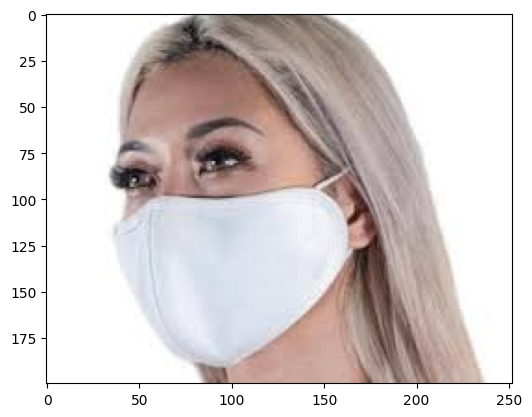

In [62]:
# dispalying sample masked image
img = mpimg.imread("/content/data/with_mask/with_mask_2295.jpg")
imgplot = plt.imshow(img)
plt.show()

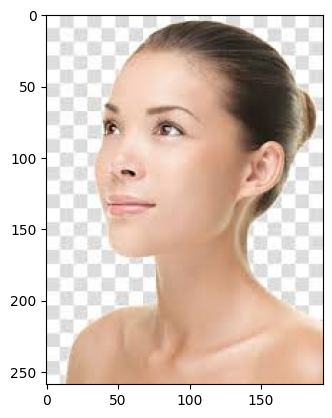

In [63]:
# dispalying sample no mask image
img = mpimg.imread("/content/data/without_mask/without_mask_2925.jpg")
imgplot = plt.imshow(img)
plt.show()

In [64]:
# converting images to numpy array
masked_path = "/content/data/with_mask/"
data = []

for img_file in masked:
  image = Image.open(masked_path + img_file)
  image = image.resize((128, 128))
  image = image.convert("RGB")
  image = np.array(image)
  data.append(image)

no_mask_path = "/content/data/without_mask/"
for img_file in no_mask:
  image = Image.open(no_mask_path + img_file)
  image = image.resize((128, 128))
  image = image.convert("RGB")
  image = np.array(image)
  data.append(image)

/usr/local/lib/python3.12/dist-packages/PIL/Image.py:1047: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [65]:
print(len(data))
print(type(data[0]))
print(data[0].shape)

7553
<class 'numpy.ndarray'>
(128, 128, 3)


## feature & labels selection, scaling, modelling and training

In [66]:
# converting image list and label list to numpy arrays
X, y = np.array(data), np.array(labels)

print(type(X), type(y))
print(X.shape, y.shape)

<class 'numpy.ndarray'> <class 'numpy.ndarray'>
(7553, 128, 128, 3) (7553,)


In [67]:
# train test splitting
X_train, X_test, y_train, y_test = train_test_split(
    X, y,
    test_size = 0.2,
    random_state = 21
)
print(X.shape)
print(X_train.shape)
print(X_test.shape)

(7553, 128, 128, 3)
(6042, 128, 128, 3)
(1511, 128, 128, 3)


In [68]:
# scaling the data
X_train_scaled = X_train / 255
X_test_scaled = X_test / 255

### building the model

In [69]:
# model initialization
model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(128, 128,3)),

    tf.keras.layers.Conv2D(32, kernel_size=(3, 3), activation="relu"),
    tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

    tf.keras.layers.Conv2D(64, kernel_size=(3, 3), activation="relu"),
    tf.keras.layers.MaxPool2D(pool_size=(2, 2)),

    tf.keras.layers.Flatten(),

    tf.keras.layers.Dense(128, activation="relu"),
    tf.keras.layers.Dropout(0.5),

    tf.keras.layers.Dense(64, activation="relu"),
    tf.keras.layers.Dropout(0.5),

    tf.keras.layers.Dense(2, activation="softmax")

])

In [70]:
# compiling the model
model.compile(
    optimizer = "adam",
    loss = "sparse_categorical_crossentropy",
    metrics = ["acc"]
)

In [71]:
model.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_8 (Conv2D)               │ (None, 126, 126, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_8 (MaxPooling2D)  │ (None, 63, 63, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 61, 61, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_9 (MaxPooling2D)  │ (None, 30, 30, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_4 (Flatten)             │ (None, 57600)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 128)            │     7,372,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_9 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 2)              │           130 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 7,400,706 (28.23 MB)

 Trainable params: 7,400,706 (28.23 MB)

 Non-trainable params: 0 (0.00 B)

In [72]:
# training the cnn
history = model.fit(
    X_train_scaled,
    y_train,
    validation_split = 0.1,
    epochs = 6
)

Epoch 1/6
170/170 ━━━━━━━━━━━━━━━━━━━━ 10s 41ms/step - acc: 0.6723 - loss: 0.6922 - val_acc: 0.8959 - val_loss: 0.2735
Epoch 2/6
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - acc: 0.8794 - loss: 0.3158 - val_acc: 0.9157 - val_loss: 0.2274
Epoch 3/6
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - acc: 0.8950 - loss: 0.2540 - val_acc: 0.9223 - val_loss: 0.2071
Epoch 4/6
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step - acc: 0.9042 - loss: 0.2357 - val_acc: 0.9207 - val_loss: 0.1825
Epoch 5/6
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - acc: 0.9351 - loss: 0.1652 - val_acc: 0.9372 - val_loss: 0.1896
Epoch 6/6
170/170 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step - acc: 0.9390 - loss: 0.1592 - val_acc: 0.9306 - val_loss: 0.1781


## model evaluation

In [73]:
loss, acc = model.evaluate(
    X_test_scaled,
    y_test
)

48/48 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - acc: 0.9306 - loss: 0.2003


In [74]:
print("accuracy: ", acc)


accuracy:  0.9272005558013916


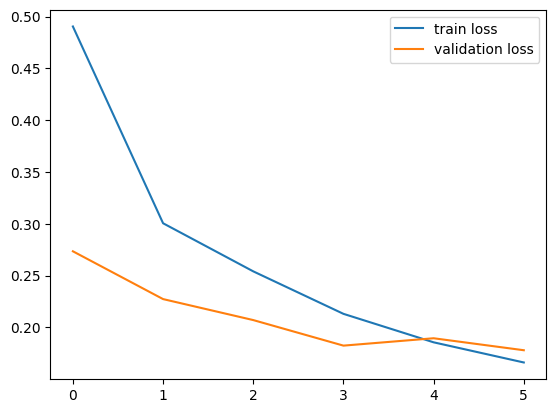

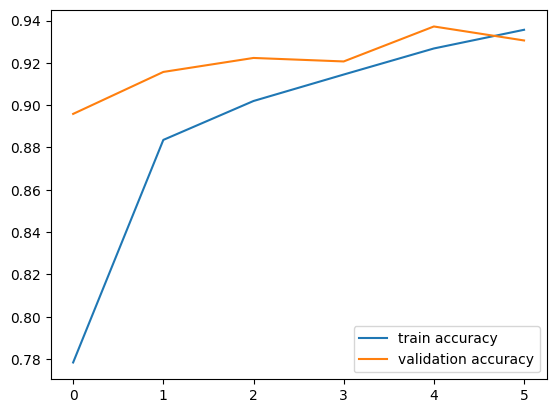

In [75]:
h = history

# loss
plt.plot(h.history["loss"], label="train loss")
plt.plot(h.history["val_loss"], label="validation loss")
plt.legend()
plt.show()

# accuracy
plt.plot(h.history["acc"], label="train accuracy")
plt.plot(h.history["val_acc"], label="validation accuracy")
plt.legend()
plt.show()

## test system

input path/content/test images/mask_girl.jpeg


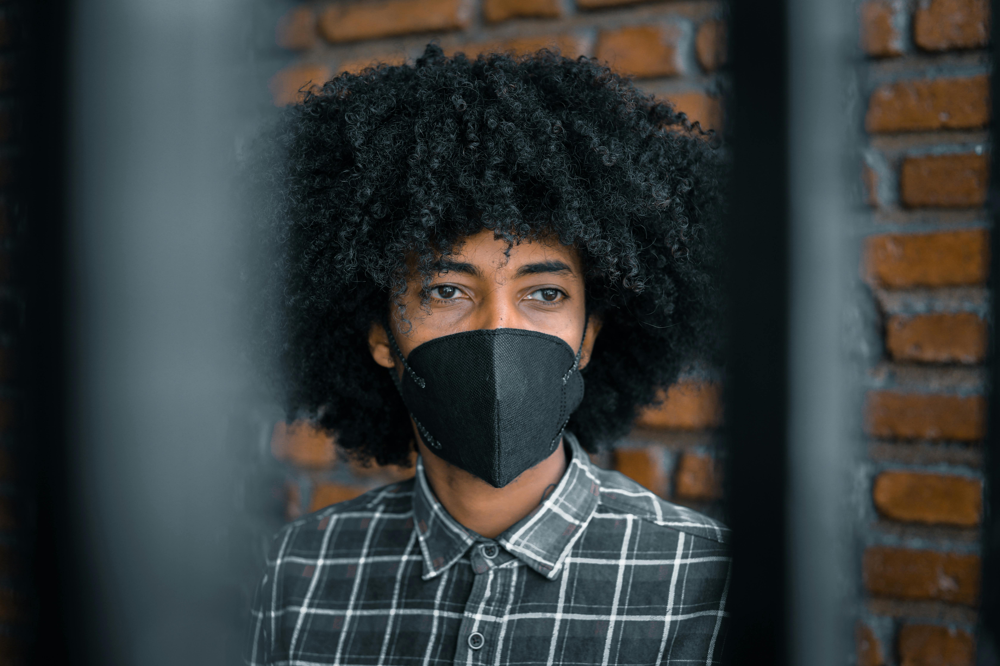

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
[[0.19566889 0.8043311 ]]
1
The person is wearing a mask


In [83]:
# simple predictive system
input_img_path = input("input path")
input_image = cv2.imread(input_img_path)
cv2_imshow(input_image)
img_resized = cv2.resize(input_image, (128, 128))
img_scaled = img_resized / 255
img_reshaped = np.reshape(img_scaled, [1, 128, 128, 3])
input_pred = model.predict(img_reshaped)
print(input_pred)
input_pred_label = np.argmax(input_pred)
print(input_pred_label)
if input_pred_label == 1:
  print("The person is wearing a mask")
else:
  print("the person is not wearing a mask")

In [77]:
# saving the model
model.save("face_mask_model.keras")

input path/content/test images/n0_mask.jpg


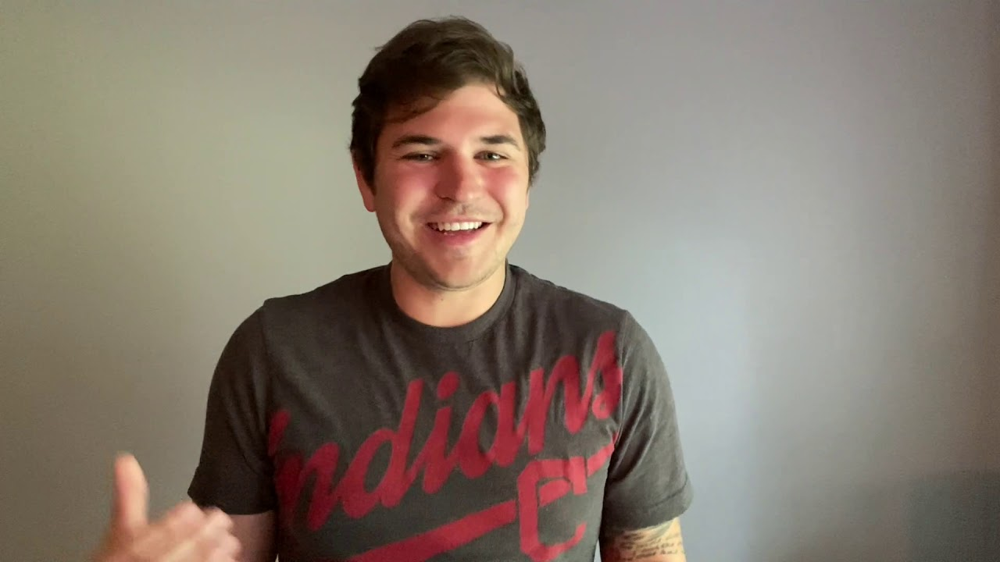

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
[[0.57183945 0.42816055]]
0
the person is not wearing a mask


In [82]:
# simple predictive system
input_img_path = input("input path")
input_image = cv2.imread(input_img_path)
cv2_imshow(input_image)
img_resized = cv2.resize(input_image, (128, 128))
img_scaled = img_resized / 255
img_reshaped = np.reshape(img_scaled, [1, 128, 128, 3])
input_pred = model.predict(img_reshaped)
print(input_pred)
input_pred_label = np.argmax(input_pred)
print(input_pred_label)
if input_pred_label == 1:
  print("The person is wearing a mask")
else:
  print("the person is not wearing a mask")

# modelling complete